In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.preprocessing import StandardScaler, LabelEncoder
from sklearn.impute import SimpleImputer
from sklearn.cluster import KMeans
from sklearn.decomposition import PCA
from sklearn.metrics import silhouette_score
from scipy.stats import zscore
from sklearn.preprocessing import StandardScaler, LabelEncoder

## Loading the dataset

In [2]:
data = pd.read_csv('data_summer_course.csv')

## Data Exploration

In [3]:
data.head()

,Mobile_Number,MAINACTBAL,LASTVCEUSGDATE,LASTRECHRGDATE,FIRSTCALLDATE,DEVICETYPE,ISDEVICE3GENABLED,VASSUBSCRIBERFLAG,ISDEVICEDATAENABLED,AGEONNETWORK,...,SUMVCEREVCD1_30,SUMDATAREVCD1_30,SUMDATAUSGCD1_30,SUMVOICEUSGCD1_30,SUMDATAUSG4GCD1_15,SUMDATAUSG4GCD15_30,SMARTPHONEFLAG,MAINACTBAL1,CNTZEROBALCD_1,FIRSTREVGENEVTDATE
0,61159748,0.2630,04/16/2023 00:00:00,04/08/2023 00:00:00,04/14/2022 00:00:00,Smartphone,Y,N,Y,368.0,...,22.985625,0.00000,1.133457e+10,12878.0,275794501.0,1.105682e+10,Y,0.26304,0,04/14/2022 00:00:00
1,17488035,0.1901,04/15/2023 00:00:00,03/26/2023 00:00:00,06/13/2007 00:00:00,Smartphone,Y,N,Y,5786.0,...,26.570050,0.00000,0.000000e+00,652.0,0.0,0.000000e+00,Y,0.19011,0,06/14/2007 00:00:00
2,43749562,0.1243,04/01/2023 00:00:00,01/31/2023 00:00:00,02/16/2022 00:00:00,Voice Centric,N,N,N,425.0,...,NaN,NaN,NaN,NaN,NaN,NaN,N,0.12430,0,02/16/2022 00:00:00
3,87451055,1.6096,04/16/2023 00:00:00,04/11/2023 00:00:00,06/29/2013 00:00:00,Smartphone,Y,N,Y,3570.0,...,30.480910,0.52052,4.288550e+05,2721.0,426609.0,2.246000e+03,Y,1.60957,0,07/08/2013 00:00:00
4,64576359,5.1838,04/16/2023 00:00:00,04/10/2023 00:00:00,04/30/2012 00:00:00,Voice Centric,N,N,N,3999.0,...,95.027229,0.00000,0.000000e+00,3123.0,0.0,0.000000e+00,N,5.18376,0,05/05/2012 00:00:00


In [4]:
data.describe()

,Mobile_Number,MAINACTBAL,AGEONNETWORK,SUBSRIBERLASTBALANCE,CNTCHURND1_30,HANDSETCHANGESFLAGD1_30,DEVICEDUALSIMFLAG,ARPUD1_30,SUMVCEREVCD1_30,SUMDATAREVCD1_30,SUMDATAUSGCD1_30,SUMVOICEUSGCD1_30,SUMDATAUSG4GCD1_15,SUMDATAUSG4GCD15_30,MAINACTBAL1,CNTZEROBALCD_1
count,2.000000e+05,200000.000000,200000.000000,200000.000000,89137.000000,35507.000000,121644.00000,200000.000000,154881.000000,151717.000000,1.551420e+05,155142.000000,1.497920e+05,1.520080e+05,200000.000000,200000.000000
mean,4.543535e+07,11.007088,1993.406405,11.007088,1.843398,1.364942,1.99649,176.082796,43.608401,2.491229,4.339707e+09,7641.116912,1.875771e+09,2.041547e+09,11.007088,0.003020
std,2.900110e+07,48.991782,1774.404666,48.991782,1.031201,0.789854,0.44538,297.788781,87.563824,6.910859,1.172820e+10,13910.996894,5.541364e+09,5.982678e+09,48.991782,0.054872
min,2.435000e+03,0.000000,101.000000,0.000000,1.000000,1.000000,1.00000,0.000000,0.000000,0.000000,0.000000e+00,0.000000,0.000000e+00,0.000000e+00,0.000000,0.000000
25%,2.015619e+07,0.008600,531.000000,0.008600,1.000000,1.000000,2.00000,0.000000,0.000000,0.000000,0.000000e+00,435.000000,0.000000e+00,0.000000e+00,0.008610,0.000000
50%,4.208031e+07,0.141900,1369.000000,0.141900,2.000000,1.000000,2.00000,58.000000,9.217591,0.000000,1.327200e+04,2573.000000,0.000000e+00,0.000000e+00,0.141880,0.000000
75%,6.797840e+07,8.298200,3129.000000,8.298200,2.000000,2.000000,2.00000,216.000000,50.621675,0.455455,1.666354e+09,8977.750000,9.751026e+07,1.794456e+08,8.298160,0.000000
max,9.998810e+07,4909.386900,6638.000000,4909.386900,8.000000,30.000000,6.00000,9251.000000,5313.730175,225.059835,2.380753e+11,666309.000000,1.588541e+11,1.048388e+11,4909.386700,1.000000


In [5]:
data.shape

(200000, 30)

## Data cleaning

In [6]:
# Identify the missing values and with how much percentage
def missing_data(data):
    total = data.isnull().sum().sort_values(ascending = False)
    percent = (data.isnull().sum()/data.isnull().count()*100).sort_values(ascending = False)
    datatypes = data.dtypes
    return pd.concat([total, percent, datatypes], axis=1, keys=['Total', 'Percent', 'datatypes'])


missing_data(data)

,Total,Percent,datatypes
HANDSETCHANGESFLAGD1_30,164493,82.2465,float64
CUSTSEGMENT,148083,74.0415,object
last_app_used,120164,60.0820,object
CNTCHURND1_30,110863,55.4315,float64
DEVICEMODELC,78356,39.1780,object
DEVICENETWORK,78356,39.1780,object
DEVICEDUALSIMFLAG,78356,39.1780,float64
SUMDATAUSG4GCD1_15,50208,25.1040,float64
SUMDATAREVCD1_30,48283,24.1415,float64
SUMDATAUSG4GCD15_30,47992,23.9960,float64


In [7]:
# Dropping the unncesarry columns 
# dropping all the columns with dates
# MAINACTBAL, MAINACTBAL1 are same, so we are going to drop 1 column out of two
# SUMDATAUSG4GCD15_30 and SUMDATAUSG4GCD1_15 are almost same because it same as 15 days, so we keep SUMDATAUSG4GCD15_30 column
# SMARTPHONEFLAG, we are dropping this because there is a column DEVICETYPE, which will also detect smartphone is there or not  
# CNTZEROBALCD_1 as it has only zeros  
# FIRSTREVGENEVTDATE, as it is a date column
# DEVICEMODELC, as it has no relevance

In [8]:
data = data.drop(columns=['LASTVCEUSGDATE', 'LASTRECHRGDATE', 'FIRSTCALLDATE', 
                          'LASTREVGENEVTDATE', 'last_app_used','CNTCHURND1_30',
                          'FIRSTREVGENEVTDATE','Mobile_Number', 'MAINACTBAL1', 
                          'SMARTPHONEFLAG', 'SUMDATAUSG4GCD1_15', 'DEVICEMODELC'], axis=1)

In [10]:
data = data.drop(columns=['CNTZEROBALCD_1'], axis=1)

In [11]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 200000 entries, 0 to 199999
Data columns (total 17 columns):
 #   Column                   Non-Null Count   Dtype  
---  ------                   --------------   -----  
 0   MAINACTBAL               200000 non-null  float64
 1   DEVICETYPE               200000 non-null  object 
 2   ISDEVICE3GENABLED        200000 non-null  object 
 3   VASSUBSCRIBERFLAG        200000 non-null  object 
 4   ISDEVICEDATAENABLED      200000 non-null  object 
 5   AGEONNETWORK             200000 non-null  float64
 6   SUBSRIBERLASTBALANCE     200000 non-null  float64
 7   CUSTSEGMENT              51917 non-null   object 
 8   HANDSETCHANGESFLAGD1_30  35507 non-null   float64
 9   DEVICENETWORK            121644 non-null  object 
 10  DEVICEDUALSIMFLAG        121644 non-null  float64
 11  ARPUD1_30                200000 non-null  float64
 12  SUMVCEREVCD1_30          154881 non-null  float64
 13  SUMDATAREVCD1_30         151717 non-null  float64
 14  SUMD

In [12]:
# Identify numerical and categorical columns
numerical_columns = data.select_dtypes(include=['float64', 'int64']).columns
categorical_columns = data.select_dtypes(include=['object']).columns

print("Numerical Columns:\n", numerical_columns)
print("\nCategorical Columns:\n", categorical_columns)

Numerical Columns:
 Index(['MAINACTBAL', 'AGEONNETWORK', 'SUBSRIBERLASTBALANCE',
       'HANDSETCHANGESFLAGD1_30', 'DEVICEDUALSIMFLAG', 'ARPUD1_30',
       'SUMVCEREVCD1_30', 'SUMDATAREVCD1_30', 'SUMDATAUSGCD1_30',
       'SUMVOICEUSGCD1_30', 'SUMDATAUSG4GCD15_30'],
      dtype='object')

Categorical Columns:
 Index(['DEVICETYPE', 'ISDEVICE3GENABLED', 'VASSUBSCRIBERFLAG',
       'ISDEVICEDATAENABLED', 'CUSTSEGMENT', 'DEVICENETWORK'],
      dtype='object')


In [13]:
# Impute missing values in numerical columns with the median
for col in numerical_columns:
    if data[col].isnull().sum() > 0:  # Check if there are missing values
        data[col].fillna(data[col].median(), inplace=True)

# Impute missing values in categorical columns with the mode
for col in categorical_columns:
    if data[col].isnull().sum() > 0:  # Check if there are missing values
        data[col].fillna(data[col].mode()[0], inplace=True)

# Verify that there are no missing values left
missing_values_after_imputation = data.isnull().sum()
print("Missing values after imputation:\n", missing_values_after_imputation[missing_values_after_imputation > 0])


Missing values after imputation:
 Series([], dtype: int64)


C:\Users\pandi\AppData\Local\Temp\ipykernel_15588\2811848688.py:4: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


  data[col].fillna(data[col].median(), inplace=True)
C:\Users\pandi\AppData\Local\Temp\ipykernel_15588\2811848688.py:4: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For e

In [14]:
data.isnull().sum()


MAINACTBAL                 0
DEVICETYPE                 0
ISDEVICE3GENABLED          0
VASSUBSCRIBERFLAG          0
ISDEVICEDATAENABLED        0
AGEONNETWORK               0
SUBSRIBERLASTBALANCE       0
CUSTSEGMENT                0
HANDSETCHANGESFLAGD1_30    0
DEVICENETWORK              0
DEVICEDUALSIMFLAG          0
ARPUD1_30                  0
SUMVCEREVCD1_30            0
SUMDATAREVCD1_30           0
SUMDATAUSGCD1_30           0
SUMVOICEUSGCD1_30          0
SUMDATAUSG4GCD15_30        0
dtype: int64

In [15]:
data.head()


,MAINACTBAL,DEVICETYPE,ISDEVICE3GENABLED,VASSUBSCRIBERFLAG,ISDEVICEDATAENABLED,AGEONNETWORK,SUBSRIBERLASTBALANCE,CUSTSEGMENT,HANDSETCHANGESFLAGD1_30,DEVICENETWORK,DEVICEDUALSIMFLAG,ARPUD1_30,SUMVCEREVCD1_30,SUMDATAREVCD1_30,SUMDATAUSGCD1_30,SUMVOICEUSGCD1_30,SUMDATAUSG4GCD15_30
0,0.2630,Smartphone,Y,N,Y,368.0,0.2630,Silver,1.0,4G,2.0,620.0,22.985625,0.00000,1.133457e+10,12878.0,1.105682e+10
1,0.1901,Smartphone,Y,N,Y,5786.0,0.1901,Basic,1.0,4G,2.0,100.0,26.570050,0.00000,0.000000e+00,652.0,0.000000e+00
2,0.1243,Voice Centric,N,N,N,425.0,0.1243,Basic,1.0,4G,2.0,0.0,9.217591,0.00000,1.327200e+04,2573.0,0.000000e+00
3,1.6096,Smartphone,Y,N,Y,3570.0,1.6096,Basic,1.0,4G,2.0,91.0,30.480910,0.52052,4.288550e+05,2721.0,2.246000e+03
4,5.1838,Voice Centric,N,N,N,3999.0,5.1838,Basic,1.0,4G,2.0,88.0,95.027229,0.00000,0.000000e+00,3123.0,0.000000e+00


In [16]:
data.shape

(200000, 17)

In [17]:
# Outlier detection and treatment Using Z-score
z_scores = zscore(data.select_dtypes(include=['float64', 'int64']))
abs_z_scores = abs(z_scores)
filtered_entries = (abs_z_scores < 3).all(axis=1)
data = data[filtered_entries]

# Ensure data consistency - check for duplicates
data.drop_duplicates(inplace=True)

In [18]:
data.shape

(175476, 17)

## Data Transformation

In [19]:
# Separate numerical and categorical columns
numerical_cols = data.select_dtypes(include=['int64', 'float64']).columns
categorical_cols = data.select_dtypes(include=['object', 'category']).columns

# Standardize the numerical features
scaler = StandardScaler()
data[numerical_cols] = scaler.fit_transform(data[numerical_cols])

# Encode categorical features using Label Encoding
label_encoders = {}
for col in categorical_cols:
    le = LabelEncoder()
    data[col] = le.fit_transform(data[col].astype(str))
    label_encoders[col] = le

# Display the transformed dataset
data.head()

,MAINACTBAL,DEVICETYPE,ISDEVICE3GENABLED,VASSUBSCRIBERFLAG,ISDEVICEDATAENABLED,AGEONNETWORK,SUBSRIBERLASTBALANCE,CUSTSEGMENT,HANDSETCHANGESFLAGD1_30,DEVICENETWORK,DEVICEDUALSIMFLAG,ARPUD1_30,SUMVCEREVCD1_30,SUMDATAREVCD1_30,SUMDATAUSGCD1_30,SUMVOICEUSGCD1_30,SUMDATAUSG4GCD15_30
0,-0.426739,1,1,0,1,-0.922943,-0.426739,3,-0.194258,3,0.191987,3.020116,-0.095334,-0.341210,2.229387,1.173835,4.857063
1,-0.430661,1,1,0,1,2.143775,-0.430661,0,-0.194258,3,0.191987,-0.076832,-0.019324,-0.341210,-0.321856,-0.598280,-0.282399
2,-0.434201,2,0,0,0,-0.890680,-0.434201,0,-0.194258,3,0.191987,-0.672400,-0.387294,-0.341210,-0.321853,-0.319838,-0.282399
3,-0.354291,1,1,0,1,0.889466,-0.354291,0,-0.194258,3,0.191987,-0.130434,0.063608,-0.175843,-0.321760,-0.298386,-0.282398
4,-0.161996,2,0,0,0,1.132290,-0.161996,0,-0.194258,3,0.191987,-0.148301,1.432353,-0.341210,-0.321856,-0.240117,-0.282399


## Data Visualisation

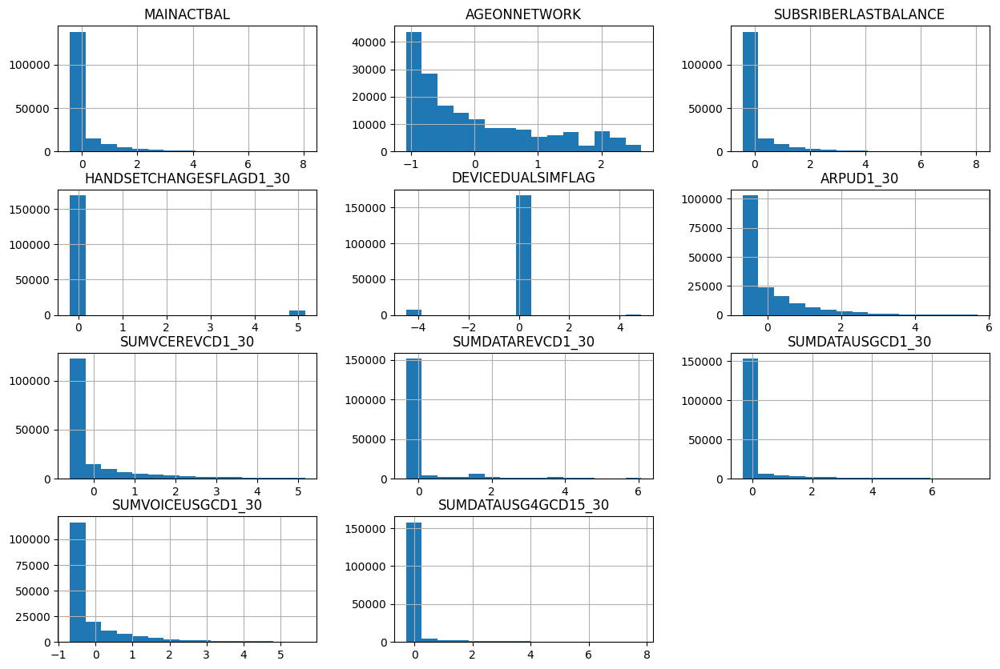

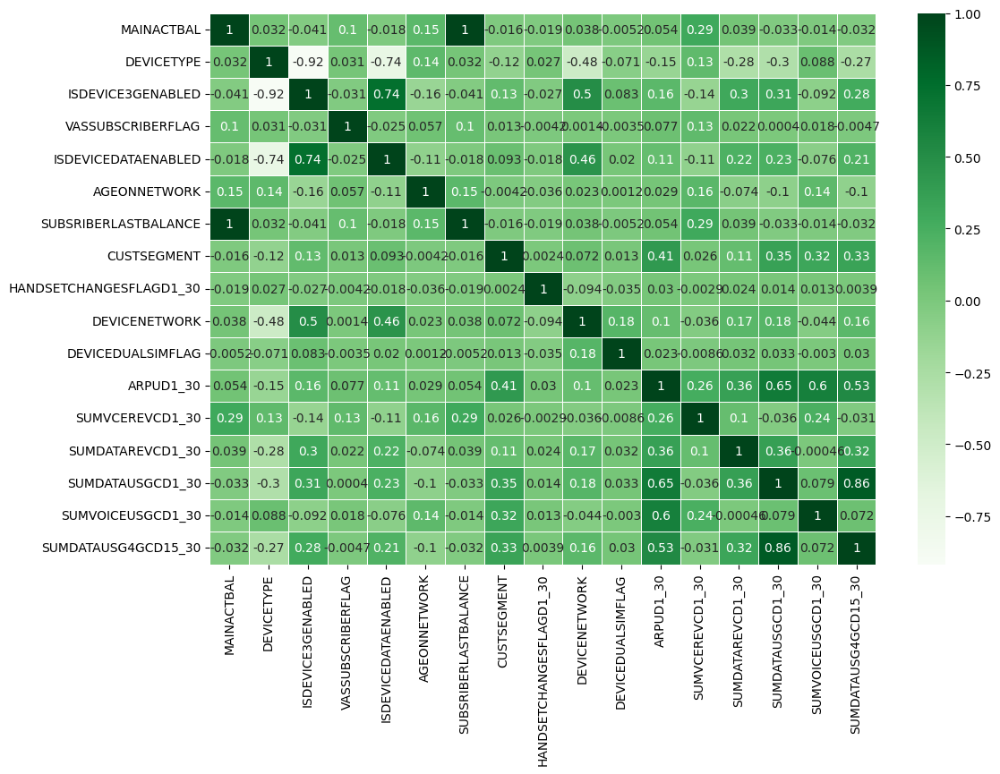

In [20]:
# Univariate analysis - Histograms for numerical columns
data[numerical_columns].hist(bins=15, figsize=(15, 10))
plt.show()

# # Bivariate analysis - Scatter plots
# sns.pairplot(data[numerical_columns])
# plt.show()

# Multivariate analysis - Heatmap of correlations
plt.figure(figsize=(12, 8))
sns.heatmap(data.corr(), annot=True, cmap='Greens', linewidths=0.5)
plt.show()


In [21]:
data.columns

Index(['MAINACTBAL', 'DEVICETYPE', 'ISDEVICE3GENABLED', 'VASSUBSCRIBERFLAG',
       'ISDEVICEDATAENABLED', 'AGEONNETWORK', 'SUBSRIBERLASTBALANCE',
       'CUSTSEGMENT', 'HANDSETCHANGESFLAGD1_30', 'DEVICENETWORK',
       'DEVICEDUALSIMFLAG', 'ARPUD1_30', 'SUMVCEREVCD1_30', 'SUMDATAREVCD1_30',
       'SUMDATAUSGCD1_30', 'SUMVOICEUSGCD1_30', 'SUMDATAUSG4GCD15_30'],
      dtype='object')

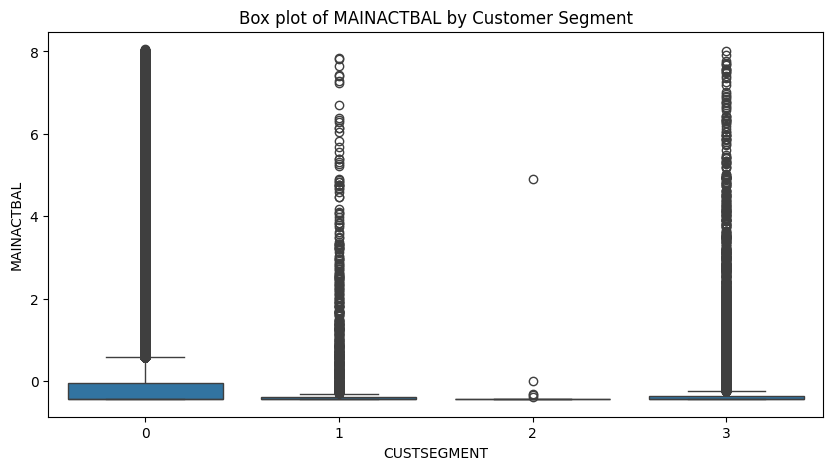

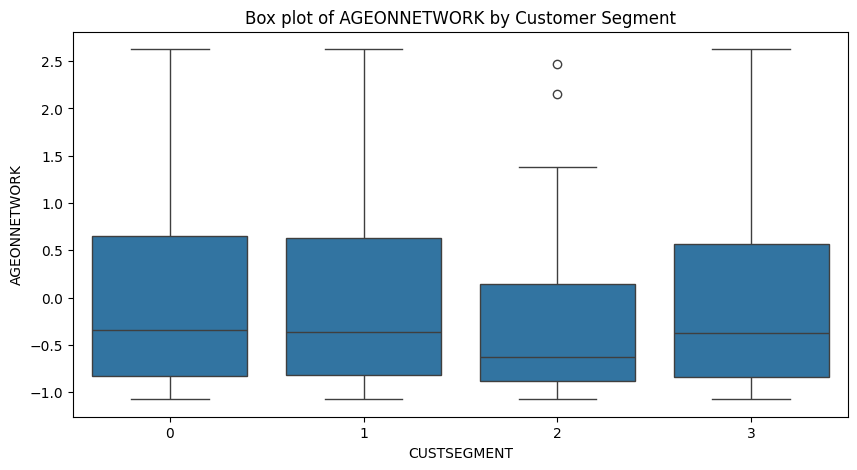

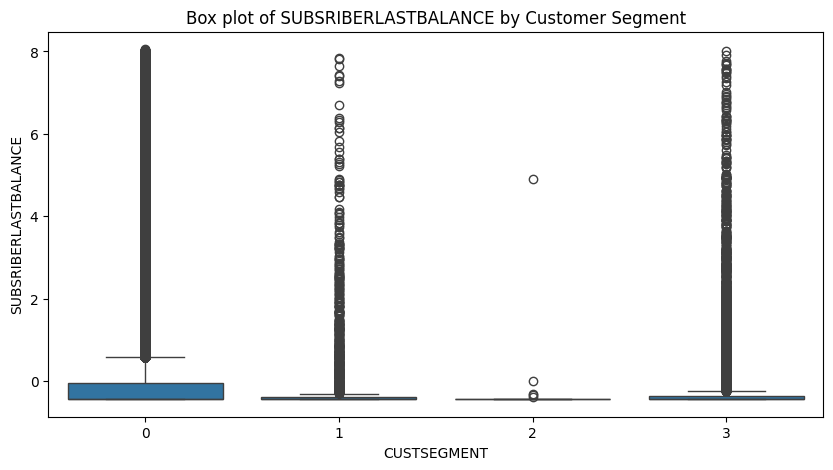

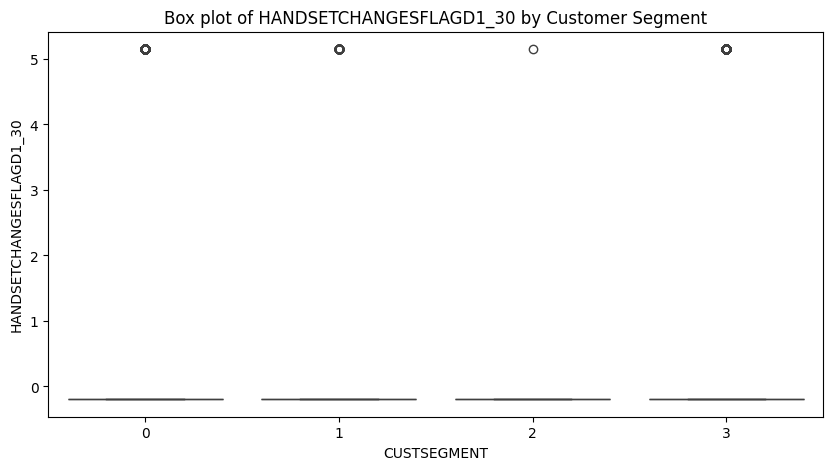

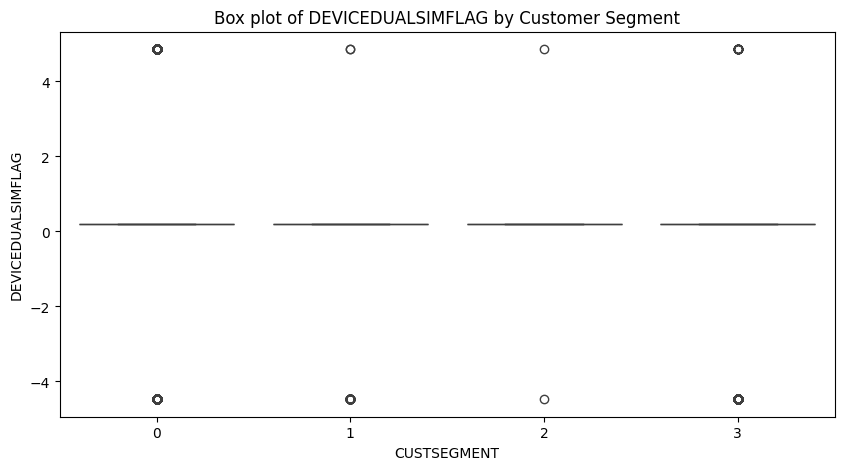

...

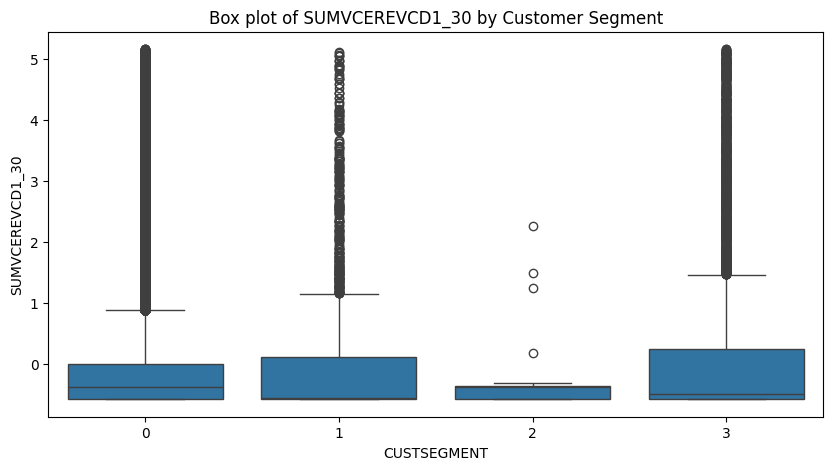

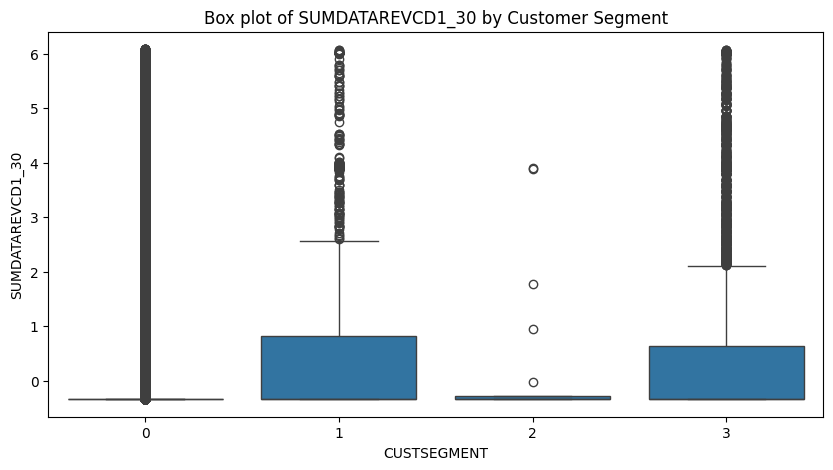

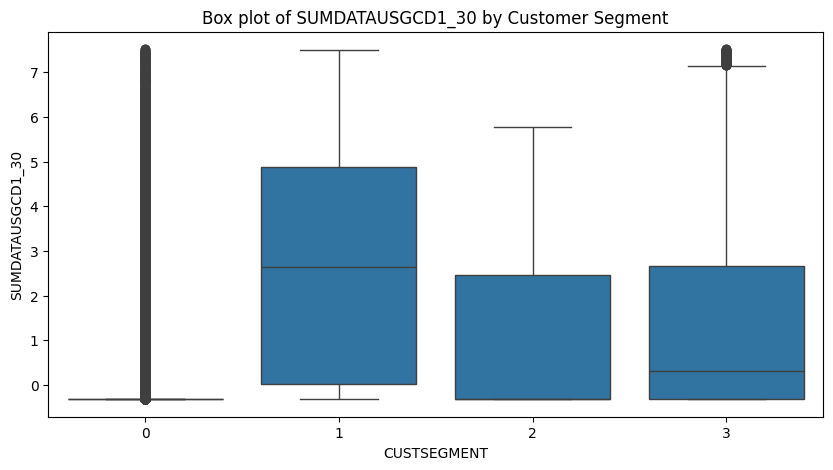

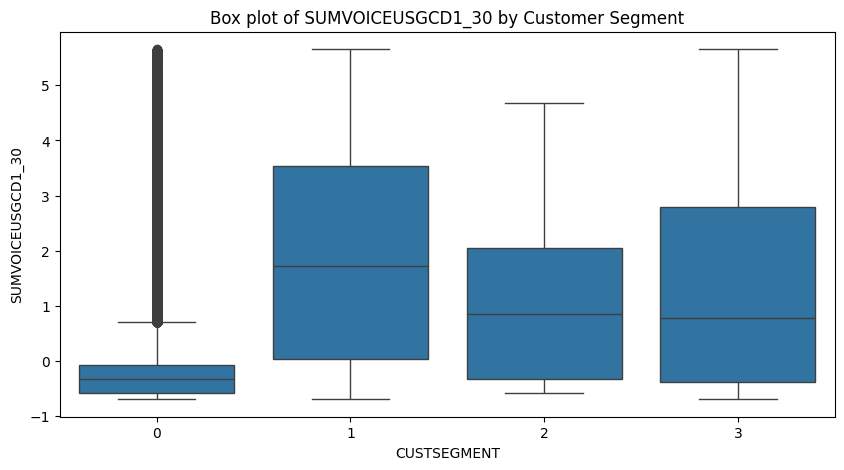

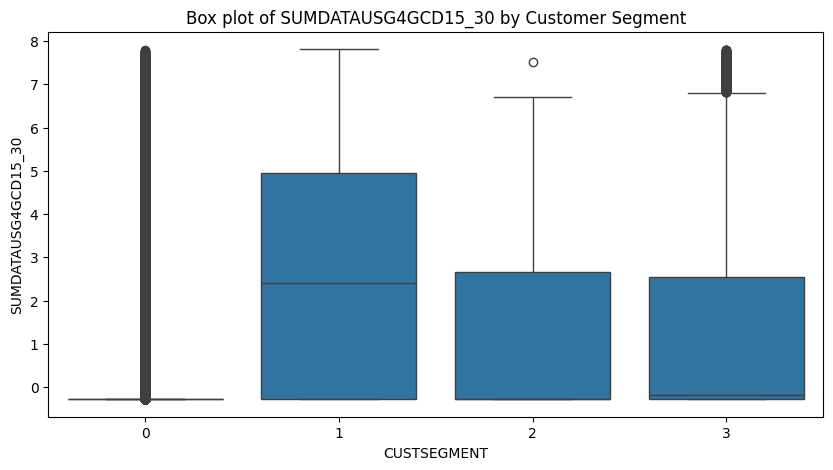

C:\Users\pandi\AppData\Local\Temp\ipykernel_15588\2228113690.py:11: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.countplot(x=col, data=data, palette='Set2')


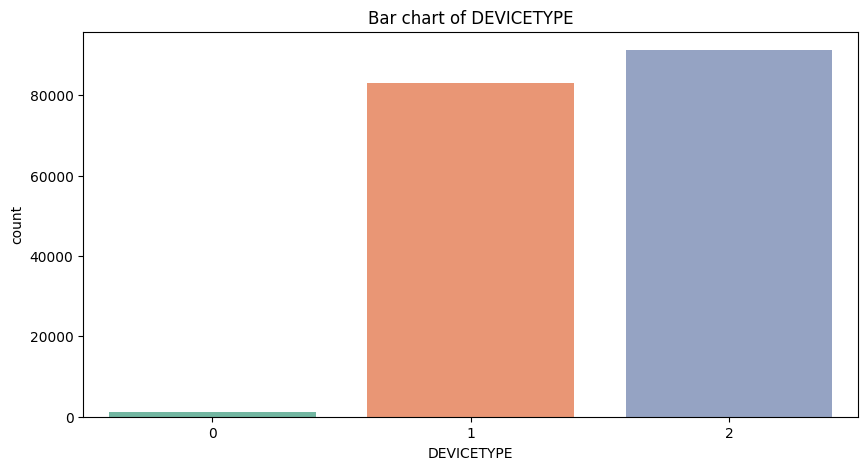

C:\Users\pandi\AppData\Local\Temp\ipykernel_15588\2228113690.py:11: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.countplot(x=col, data=data, palette='Set2')


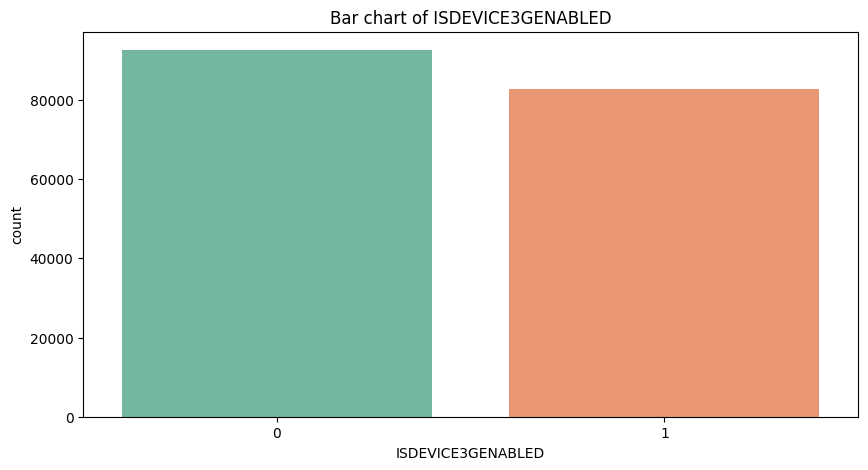

C:\Users\pandi\AppData\Local\Temp\ipykernel_15588\2228113690.py:11: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.countplot(x=col, data=data, palette='Set2')


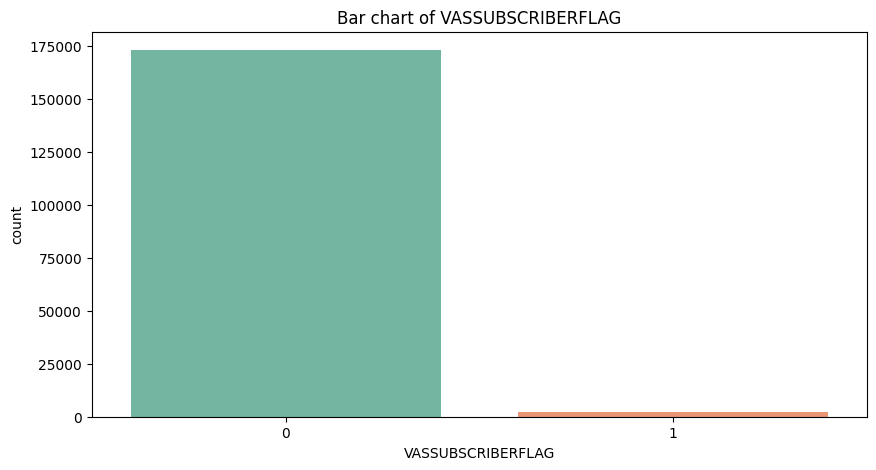

C:\Users\pandi\AppData\Local\Temp\ipykernel_15588\2228113690.py:11: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.countplot(x=col, data=data, palette='Set2')


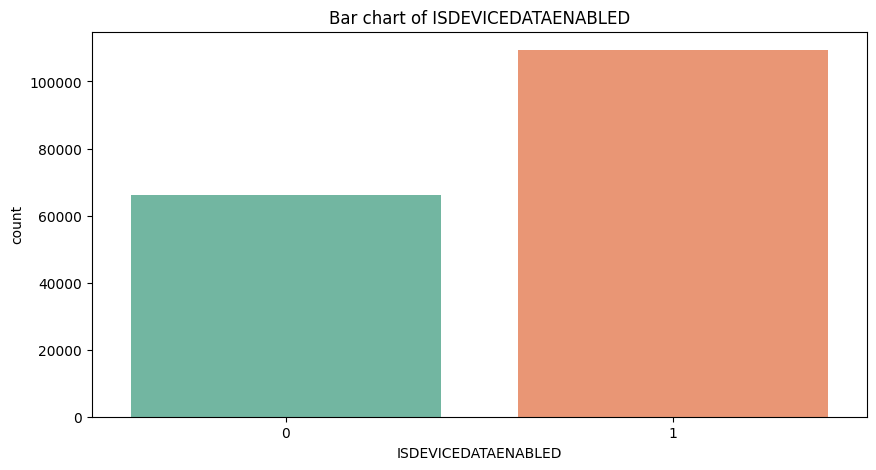

C:\Users\pandi\AppData\Local\Temp\ipykernel_15588\2228113690.py:11: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.countplot(x=col, data=data, palette='Set2')


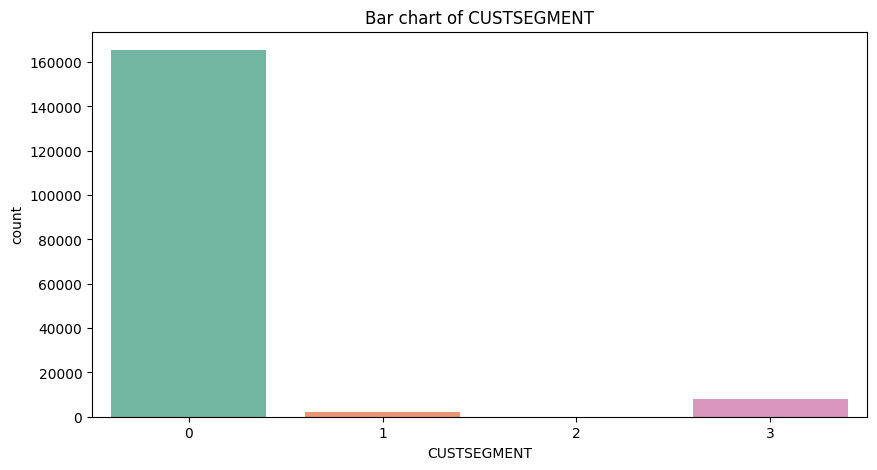

C:\Users\pandi\AppData\Local\Temp\ipykernel_15588\2228113690.py:11: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.countplot(x=col, data=data, palette='Set2')


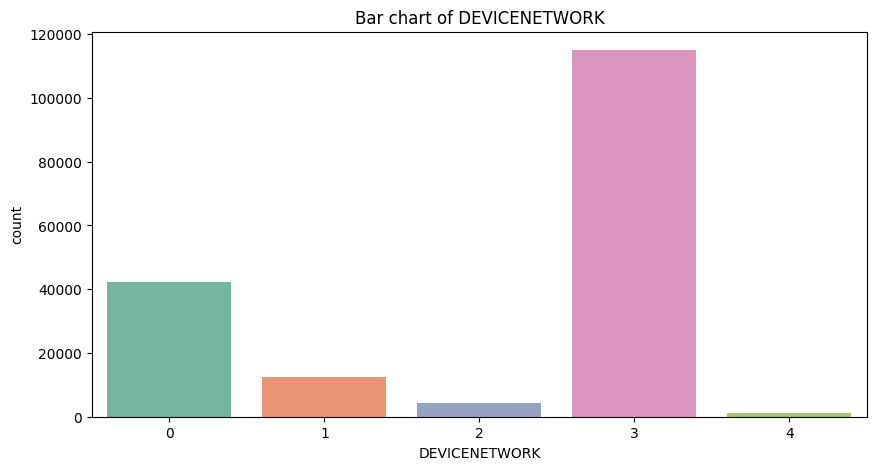

In [22]:
# Box plots to understand customer segments
for col in numerical_columns:
    plt.figure(figsize=(10, 5))
    sns.boxplot(x='CUSTSEGMENT', y=col, data=data)
    plt.title(f'Box plot of {col} by Customer Segment')
    plt.show()

# Bar charts for categorical variables
for col in categorical_columns:
    plt.figure(figsize=(10, 5))
    sns.countplot(x=col, data=data, palette='Set2')
    plt.title(f'Bar chart of {col}')
    plt.show()

## Model Building

In [23]:
data.info()

<class 'pandas.core.frame.DataFrame'>
Index: 175476 entries, 0 to 199999
Data columns (total 17 columns):
 #   Column                   Non-Null Count   Dtype  
---  ------                   --------------   -----  
 0   MAINACTBAL               175476 non-null  float64
 1   DEVICETYPE               175476 non-null  int32  
 2   ISDEVICE3GENABLED        175476 non-null  int32  
 3   VASSUBSCRIBERFLAG        175476 non-null  int32  
 4   ISDEVICEDATAENABLED      175476 non-null  int32  
 5   AGEONNETWORK             175476 non-null  float64
 6   SUBSRIBERLASTBALANCE     175476 non-null  float64
 7   CUSTSEGMENT              175476 non-null  int32  
 8   HANDSETCHANGESFLAGD1_30  175476 non-null  float64
 9   DEVICENETWORK            175476 non-null  int32  
 10  DEVICEDUALSIMFLAG        175476 non-null  float64
 11  ARPUD1_30                175476 non-null  float64
 12  SUMVCEREVCD1_30          175476 non-null  float64
 13  SUMDATAREVCD1_30         175476 non-null  float64
 14  SUMDATAUS

#### Dropping all the categorical columns

In [24]:
data = data.drop(columns=['DEVICETYPE', 'ISDEVICE3GENABLED', 'VASSUBSCRIBERFLAG', 
                   'ISDEVICEDATAENABLED', 'CUSTSEGMENT', 'DEVICENETWORK', 'DEVICEDUALSIMFLAG'], axis=1)

In [25]:
data.head()

,MAINACTBAL,AGEONNETWORK,SUBSRIBERLASTBALANCE,HANDSETCHANGESFLAGD1_30,ARPUD1_30,SUMVCEREVCD1_30,SUMDATAREVCD1_30,SUMDATAUSGCD1_30,SUMVOICEUSGCD1_30,SUMDATAUSG4GCD15_30
0,-0.426739,-0.922943,-0.426739,-0.194258,3.020116,-0.095334,-0.341210,2.229387,1.173835,4.857063
1,-0.430661,2.143775,-0.430661,-0.194258,-0.076832,-0.019324,-0.341210,-0.321856,-0.598280,-0.282399
2,-0.434201,-0.890680,-0.434201,-0.194258,-0.672400,-0.387294,-0.341210,-0.321853,-0.319838,-0.282399
3,-0.354291,0.889466,-0.354291,-0.194258,-0.130434,0.063608,-0.175843,-0.321760,-0.298386,-0.282398
4,-0.161996,1.132290,-0.161996,-0.194258,-0.148301,1.432353,-0.341210,-0.321856,-0.240117,-0.282399


In [26]:
#K-means Clustering
model=KMeans(n_clusters=4,random_state=75, max_iter=100)
model.fit(data)

KMeans(max_iter=100, n_clusters=4, random_state=75)

In [27]:
# cluster labels
labels=model.labels_
labels

array([2, 0, 0, ..., 0, 0, 0])

In [28]:
# data is reduced to two principal components
pca=PCA(n_components=2)
data_pca=pca.fit_transform(data)

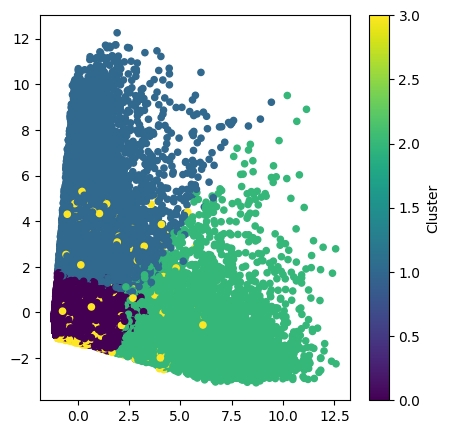

In [29]:
# plot the clusters
plt.figure(figsize=(5,5))
plt.scatter(data_pca[:,0],data_pca[:,1],c=labels,cmap='viridis',s=20)
plt.colorbar(label='Cluster')
plt.show()

## Validating our model

#### Elbow method

Text(0, 0.5, 'Inertia score (SSE)')

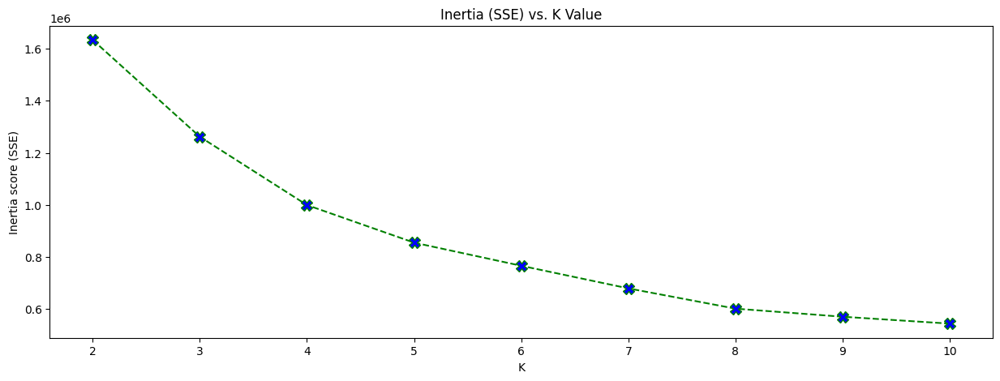

In [35]:
k1 = range(2,11)
inertia_s1 = []

for i in k1:
    kmeans1 = KMeans(n_clusters=i,random_state=75,max_iter=200).fit(data)
    inertia_s1.append(kmeans1.inertia_)

# plot
plt.figure(figsize=(15,5))
plt.plot(k1,inertia_s1,color='green', linestyle='dashed', marker='X',
         markerfacecolor='blue', markersize=10)
plt.title('Inertia (SSE) vs. K Value')
plt.xlabel('K')
plt.ylabel('Inertia score (SSE)')

#### Sillhoutte Score

In [36]:
for i in range(2,11):
    labels1=KMeans(n_clusters=i,random_state=75, max_iter=200).fit(data).labels_
    print ("Silhoutte score for k= "+str(i)+" is "+str(silhouette_score(data,labels1,metric="manhattan",
                                 sample_size=1000,random_state=200)))

Silhoutte score for k= 2 is 0.5365164887250756
Silhoutte score for k= 3 is 0.5823182938755486
Silhoutte score for k= 4 is 0.5434042028177848
Silhoutte score for k= 5 is 0.4423946706277952
Silhoutte score for k= 6 is 0.43803498305420857
Silhoutte score for k= 7 is 0.2996764926061291
Silhoutte score for k= 8 is 0.3084181425825443
Silhoutte score for k= 9 is 0.3019914371291273
Silhoutte score for k= 10 is 0.3055646815615524


In [32]:
# As we can see at k=4 the silhoutte score decreasing so we take optimal cluster k=4

## Cluster Profiling

In [39]:
# Add cluster labels
data['cluster_ids'] = model.labels_

# Overall level summary
df_profile_overall = data.describe().T
# using mean; use appropriate summarization (median, count, etc.) for each feature
df_profile_overall['Overall Dataset'] = df_profile_overall[['mean']]
df_profile_overall = df_profile_overall[['Overall Dataset']]

# Cluster ID level summary
df_cluster_summary = data.groupby('cluster_ids').describe().T.reset_index()
df_cluster_summary = df_cluster_summary.rename(columns={'level_0':'column','level_1':'metric'})

# using mean; use appropriate summarization (median, count, etc.) for each feature
df_cluster_summary = df_cluster_summary[df_cluster_summary['metric'] == "mean"]
df_cluster_summary = df_cluster_summary.set_index('column')
df_cluster_summary
# join into single summary dataset
df_profile = df_cluster_summary.join(df_profile_overall) # joins on Index
df_profile

,metric,0,1,2,3,Overall Dataset
column,,,,,,
MAINACTBAL,mean,-0.274923,2.083802,-0.160676,-0.153616,3.146252e-17
AGEONNETWORK,mean,-0.044976,0.571975,-0.326554,-0.184086,-2.721083e-17
SUBSRIBERLASTBALANCE,mean,-0.274923,2.083802,-0.160676,-0.153616,3.146252e-17
HANDSETCHANGESFLAGD1_30,mean,-0.194258,-0.176783,-0.115965,5.147792,-2.126251e-16
ARPUD1_30,mean,-0.236768,0.252788,2.310850,0.071961,2.393095e-17
SUMVCEREVCD1_30,mean,-0.202536,1.453795,-0.025711,-0.032145,-1.166178e-17
SUMDATAREVCD1_30,mean,-0.145827,0.016206,1.641843,0.068575,2.429538e-17
SUMDATAUSGCD1_30,mean,-0.227195,-0.242666,3.083991,-0.050645,1.619692e-18
SUMVOICEUSGCD1_30,mean,-0.073297,0.247796,0.420033,0.049827,-6.743993e-17


In [44]:
import plotly.express as px

# Performing PCA to reduce dimensions to 3 components
pca = PCA(n_components=3)
pca_data = pca.fit_transform(data)

# Adding the PCA components to the dataframe
data['PCA1'] = pca_data[:, 0]
data['PCA2'] = pca_data[:, 1]
data['PCA3'] = pca_data[:, 2]

# Visualizing the clusters in 3D
fig = px.scatter_3d(data, x='PCA1', y='PCA2', z='PCA3', color='MAINACTBAL',size_max=18,opacity=0.7,
                    title='Customer Segments based on PCA',
                    labels={'PCA1': 'Principal Component 1', 
                            'PCA2': 'Principal Component 2', 
                            'PCA3': 'Principal Component 3'},
                    color_continuous_scale=px.colors.sequential.Viridis)
fig.show()